# ResOpsPT: stations
***

***Author:** Chus Casado Rodríguez*<br>
***Date:** 21-03-2025*<br>



In [1]:
import os
os.environ['USE_PYGEOS'] = '0'
import numpy as np
import pandas as pd
import geopandas as gpd
from shapely import Point
from shapely.geometry import box
from pathlib import Path
import yaml
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from datetime import datetime

In [2]:
from lisfloodreservoirs.utils.utils import filter_reservoirs, remove_duplicates
from lisfloodreservoirs.utils import DatasetConfig

## Configuration

In [16]:
cfg = DatasetConfig('config_dataset.yml')

PATH_HDMS = Path('Z:/nahaUsers/casadje/datasets/hDMS/reservoir')

print(f'Attributes will be saved in {cfg.PATH_ATTRS}')

Attributes will be saved in Z:\nahaUsers\casadje\datasets\reservoirs\ResOpsPT\v1.0\attributes


## hDMS
### Reservoirs

In [22]:
reservoirs = gpd.read_file(cfg.PATH_RESOPS / 'GIS' / 'reservoirs_HDMS_20250305.shp').set_index('EFAS_ID')

print(f'{len(reservoirs)} reservoirs in the Hydrological Data Management Service')

20 reservoirs in the Hydrological Data Management Service


In [23]:
reservoirs.index.tolist()

[10341,
 10342,
 10343,
 10344,
 10345,
 10346,
 10347,
 10348,
 10349,
 10350,
 10351,
 10352,
 10353,
 10354,
 10355,
 10356,
 10357,
 10358,
 10359,
 10360]

<AxesSubplot:>

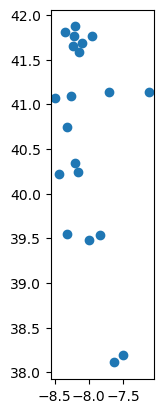

In [10]:
reservoirs.plot()

In [69]:
lfcoords = reservoirs[['CATCH_SKM', 'LAT', 'LON', 'GRAND_ID']].copy()
lfcoords = lfcoords[lfcoords.GRAND_ID.notnull()]
lfcoords[['GRAND_ID', 'CATCH_SKM']] = lfcoords[['GRAND_ID', 'CATCH_SKM']].astype(int)
lfcoords.set_index('GRAND_ID', drop=True, inplace=True)
lfcoords.index.name = 'ID'
lfcoords.columns = lfcoords.columns.str.lower()
lfcoords.rename(columns={'catch_skm': 'area'}, inplace=True)

lfcoords.to_csv(cfg.PATH_RESOPS / 'ancillary' / 'lfcoords' / 'dams.csv', float_format="%.3f")
lfcoords.head()

,area,lat,lon
ID,,,
2713,1511,41.871,-8.205
2714,1687,41.812,-8.349
2716,59,41.759,-8.217
2718,615,41.689,-8.094
2715,217,41.761,-7.957


### Time series

In [35]:
import shutil

services = {
    'HIST': 'nhoperational24hw',
    'NRT': 'noperational24h'
}

for efas_id in reservoirs.index:
    for name, service in services.items():
        file = PATH_HDMS / service / f'{efas_id}.nc'
        if file.is_file():
            print(f'Reservoir {efas_id} has {service} data')
            shutil.copy(file,cfg.PATH_OBS_TS / file.name)

In [50]:
cfg.PATH_RESOPS

WindowsPath('Z:/nahaUsers/casadje/datasets/reservoirs/ResOpsPT')

In [76]:
file_name = 'dams_1min'
grand_lf = gpd.read_file(cfg.PATH_RESOPS / 'ancillary' / 'lfcoords' / 'output' / f'{file_name}.shp')
grand_lf = grand_lf[['lon_1min', 'lat_1min', 'ID']]
grand_lf.columns = ['lon', 'lat', 'ID']
grand_lf.to_csv(cfg.PATH_RESOPS / 'ancillary' / 'cutmaps' / f'{file_name}.txt', header=None, index=None, sep='\t')
grand_lf.to_csv(cfg.PATH_RESOPS / 'ancillary' / 'ncextract' /f'{file_name}.csv', index=None)

In [77]:
grand_lf.head()

,lon,lat,ID
0,-8.208333,41.875000,2713
1,-8.341667,41.808333,2714
2,-8.191667,41.775000,2716
3,-8.091667,41.691667,2718
4,-7.958333,41.758333,2715


In [8]:
reservoirs.head()

,ALIVE,BASIN_EN,BASIN_LOC,CATCH_SKM,COMMENT,COMMENT_,COORD_TEST,COUNTRY,COUNTRY_ID,DAM_HGT_M,...,RES_NAME,RIVER_EN,RIVER_LOC,START,STATE,WEB_SITE,X,Y,GRAND_ID,geometry
EFAS_ID,,,,,,,,,,,,,,,,,,,,,
10341,0,lima,lima,1511.0,None,RIVERNAME UPDATED FROM Rio Lima TO Lima,0.0,Portugal,PT,275.0,...,alto lindoso,lima,rio lima,01/01/1992,None,None,None,None,2713.0,POINT (-8.20500 41.87100)
10342,0,lima,lima,1687.0,None,RIVERNAME UPDATED FROM Rio Lima TO Lima,0.0,Portugal,PT,62.0,...,touvedo,lima,lima,01/01/1993,None,None,None,None,2714.0,POINT (-8.34900 41.81200)
10343,0,cavado,cavado,59.0,None,None,0.0,Portugal,PT,497.0,...,vilarinho das furnas,homem,homem,01/01/1972,None,None,None,None,2716.0,POINT (-8.21700 41.75900)
10344,0,cavado,cavado,615.0,None,None,0.0,Portugal,PT,271.0,...,salamonde,cavado,cavado,01/01/1953,None,None,None,None,2718.0,POINT (-8.09400 41.68900)
10345,0,cavado,cavado,217.0,None,None,0.0,Portugal,PT,672.0,...,paradela,cavado,cavado,01/01/1956,None,None,None,None,2715.0,POINT (-7.95700 41.76100)


In [225]:
# stations reporting volume
stations_vol = pd.read_csv(cfg.PATH_RESOPS / 'raw' / 'attributes' / 'stations_volume.csv')
rename_cols = {
    'station_name': 'name',
    'station_no': 'number',
    'station_number': 'number',
    'station_id': 'id',
    'station_latitude': 'latitude',
    'station_longitude': 'longitude'
}
stations_vol.rename(columns=rename_cols, inplace=True, errors='ignore')
stations_vol.name = stations_vol.name.str.lower()
stations_vol.set_index('number', drop=True, inplace=True)
stations_vol[['latitude', 'longitude']] = stations_vol[['latitude', 'longitude']].astype(float)
stations_vol['volume'] = True

# remove stations without coordinates
missing_coords = stations_vol.latitude.isnull() | stations_vol.longitude.isnull()
print('{0} stations are missing coordinates'.format(missing_coords.sum()))
stations_vol = stations_vol[~missing_coords]

# remove stations without time series
missing_ts = [no for no in set(stations_vol.index) if (cfg.PATH_OBS_TS / f'{no}_volume.csv').is_file() is False]
print('{0} stations are missing the time series'.format(len(missing_ts)))
stations_vol.drop(missing_ts, axis=0, inplace=True)

# # remove stations with wrong coordinates
stations_vol = gpd.GeoDataFrame(
    stations_vol,
    geometry=[Point(xy) for xy in zip(stations_vol.longitude, stations_vol.latitude)],
    crs='epsg:4326'
)
mask_extent = stations_vol.geometry.within(extent)
print('{0} stations have wrong coordinates'.format((~mask_extent).sum()))
stations_vol = stations_vol[mask_extent]

print('{0} stations contain meta data'.format(len(stations_vol)))
print('{0} stations contain volume data'.format(len(set(stations_vol.index))))

10 stations are missing coordinates
30 stations are missing the time series
15 stations have wrong coordinates
566 stations contain meta data
525 stations contain volume data


#### Level

In [236]:
# stations reporting level
stations_lev = pd.read_csv(cfg.PATH_RESOPS / 'raw' / 'attributes' / 'stations_level.csv')
stations_lev.rename(columns=rename_cols, inplace=True, errors='ignore')
stations_lev.name = stations_lev.name.str.lower()
stations_lev.set_index('number', drop=True, inplace=True)
stations_lev[['latitude', 'longitude']] = stations_lev[['latitude', 'longitude']].astype(float)
stations_lev['level'] = True

# remove stations without coordinates
missing_coords = stations_lev.latitude.isnull() | stations_lev.longitude.isnull()
print('{0} stations are missing coordinates'.format(missing_coords.sum()))
stations_lev = stations_lev[~missing_coords]

# remove stations without time series
missing_ts = [no for no in set(stations_lev.index) if (cfg.PATH_OBS_TS / f'{no}_level.csv').is_file() is False]
print('{0} stations are missing the time series'.format(len(missing_ts)))
stations_lev.drop(missing_ts, axis=0, inplace=True)

# remove stations with wrong coordinates
stations_lev = gpd.GeoDataFrame(
    stations_lev,
    geometry=[Point(xy) for xy in zip(stations_lev.longitude, stations_lev.latitude)],
    crs='epsg:4326'
)
mask_extent = stations_lev.geometry.within(extent)
print('{0} stations have wrong coordinates'.format((~mask_extent).sum()))
stations_lev = stations_lev[mask_extent]

print('{0} stations contain meta data'.format(len(stations_lev)))
print('{0} stations contain level data'.format(len(set(stations_lev.index))))

12 stations are missing coordinates
50 stations are missing the time series
15 stations have wrong coordinates
597 stations contain meta data
556 stations contain level data


### Processing

In [241]:
# intersection and difference between the two sets of stations
ids_int = stations_vol.index.intersection(stations_lev.index)
ids_diff = stations_lev.index.difference(stations_vol.index)

# update 'level' attribute in 'stations_vol'
stations_vol['level'] = False
stations_vol.loc[ids_int, 'level'] = True

# update 'volume' attribute in 'stations_lev'
stations_lev['volume'] = False
stations_lev.loc[ids_int, 'volume'] = True

# concatenate both sets
stations = pd.concat((stations_vol, stations_lev.loc[ids_diff, :]), axis=0)
print('{0} stations contain either metadata'.format(len(stations)))
print('{0} stations contain either volume or level data'.format(len(set(stations.index))))

664 stations contain either metadata
623 stations contain either volume or level data


In [249]:
# remove duplicated station number
stations_ = remove_duplicates(stations.reset_index(), duplicates_col='number', select_col='id', ascending=True).set_index('number')

<AxesSubplot:>

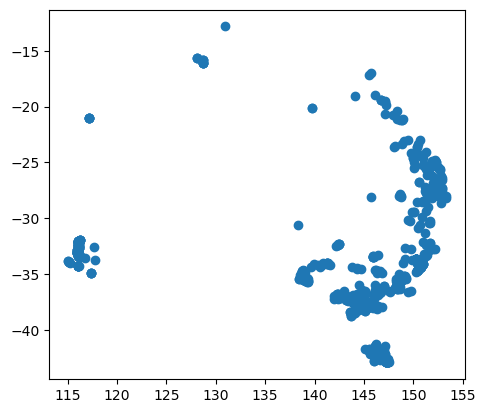

In [250]:
stations_.plot()

In [11]:
# # convert to geopandas
# stations = gpd.GeoDataFrame(
#     data=stations,
#     geometry=[Point(xy) for xy in zip(stations.longitude, stations.latitude)],
#     crs='epsg:4326'
# )

721 stations contain either volume or level data


In [253]:
stations.loc['122010A']

,name,id,latitude,longitude,volume,geometry,level
number,,,,,,,
122010A,peter faust dam,113137,-20.366710,148.382200,True,POINT (148.38220 -20.36671),True
122010A,peter faust dam hw,3242359,-20.366806,148.382306,True,POINT (148.38231 -20.36681),True


In [254]:
stations_.loc['122010A']

name                    peter faust dam
id                               113137
latitude                      -20.36671
longitude                      148.3822
volume                             True
geometry     POINT (148.3822 -20.36671)
level                              True
Name: 122010A, dtype: object

In [ ]:
# # rename columns
# stations.rename(columns={'station_number': 'number', 'station_name': 'name'}, inplace=True)
# stations.index.name = 'number'

In [298]:
stations_grand = gpd.read_file(cfg.PATH_RESOPS / 'GIS' / 'stations+GRanD.shp'.format(datetime.now().strftime('%Y%m%d')))
stations_grand = stations_grand[stations_grand.GRAND_ID.notnull()]
stations_grand = remove_duplicates(stations_grand, duplicates_col='number', select_col='id', ascending=True)
stations_grand.set_index('number', drop=True, inplace=True)
stations_grand.GRAND_ID = stations_grand.GRAND_ID.astype(int)
stations_grand.shape

(228, 8)

In [299]:
no_int = stations_.index.intersection(stations_grand.index)
len(no_int)

224

In [303]:
stations_.loc[no_int, 'GRAND_ID'] = stations_grand.loc[no_int, 'GRAND_ID']
stations_.GRAND_ID = stations_.GRAND_ID.astype('Int64')

In [304]:
stations_.head()

,name,id,latitude,longitude,volume,geometry,level,GRAND_ID
number,,,,,,,,
PI_357693.1,"10 mile brook dam water level daily value, sou...",3572876,-33.963617,115.124899,True,POINT (115.12490 -33.96362),True,<NA>
408216A,amphitheatre res. hg,2705644,-37.173235,143.377498,True,POINT (143.37750 -37.17324),True,<NA>
418.1,arthurs lake - at pump station,3162458,-41.988306,146.862472,True,POINT (146.86247 -41.98831),True,<NA>
155.1,augusta lake - at intake,3162361,-41.844444,146.572222,True,POINT (146.57222 -41.84444),True,<NA>
212211,avon dam,16372090,-34.350932,150.640500,True,POINT (150.64050 -34.35093),True,6750


<AxesSubplot:>

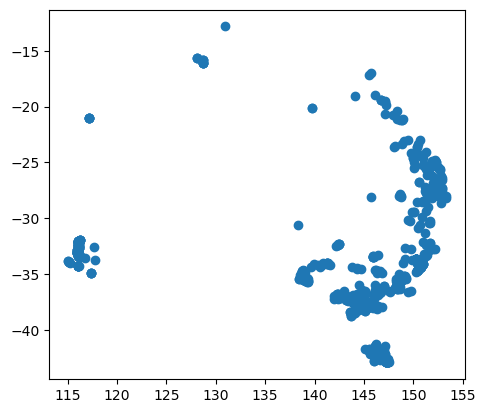

In [305]:
stations_.plot()

In [307]:
stations_.GRAND_ID.notnull().sum()

224

In [309]:
len(stations_.GRAND_ID.unique())

148

In [306]:
# export
stations_.to_file(cfg.PATH_RESOPS / 'GIS' / 'stations_{0}.shp'.format(datetime.now().strftime('%Y%m%d')))
stations_.to_csv(cfg.PATH_RESOPS / 'raw' / 'attributes' / 'stations_{0}.csv'.format(datetime.now().strftime('%Y%m%d')))

I found in QGIS the `GRAND_ID` associated with each point.

## GRanD

In [6]:
# load shapefile of dams
grand = gpd.read_file(cfg.PATH_GRAND / 'GRanD_dams_v1_3.shp')
grand.set_index('GRAND_ID', drop=False, inplace=True)

# filter dams in Spain
grand = grand.loc[grand.COUNTRY == 'Australia']

# correct names
grand.DAM_NAME = grand.DAM_NAME.str.upper()
grand.RES_NAME = grand.RES_NAME.str.upper()
grand.ADMIN_UNIT = grand.ADMIN_UNIT.str.upper()

# rename columns
grand['LON'] = grand.geometry.x
grand['LAT'] = grand.geometry.y

print('GRanD')
print('-----')
print('No. reservoirs:\t{0}\nNo. attributes:\t{1}\n'.format(*grand.shape))

GRanD
-----
No. reservoirs:	190
No. attributes:	61



104 out of 190 reservoirs exceed the minimum catchment area of 250 km2 (0 missing values)
184 out of 190 reservoirs exceed the minimum reservoir volume of 10 hm3 (0 missing values)
101 out of 190 reservoirs exceed the minimum catchment area (250 km2) and the minimum reservoir volume (10 hm3)


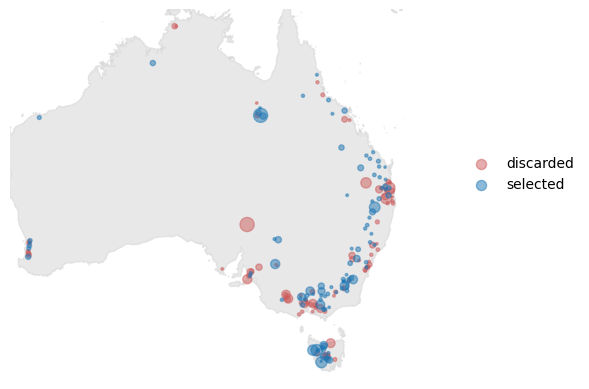

In [7]:
# select reservoirs based on catchment area and reservoir volume
mask_grand = filter_reservoirs(grand.CATCH_SKM, grand.CAP_MCM, cfg.MIN_AREA, cfg.MIN_VOL)

fig, ax = plt.subplots(subplot_kw=dict(projection=ccrs.PlateCarree()))
ax.add_feature(cfeature.NaturalEarthFeature('physical', 'land', '10m', edgecolor='face', facecolor='lightgray'),
               alpha=.5,
               zorder=0)
grand.loc[~mask_grand].plot(markersize=grand.CAP_MCM**.5, c='indianred', alpha=.5, ax=ax, label='discarded')
grand.loc[mask_grand].plot(markersize=grand.CAP_MCM**.5, alpha=.5, ax=ax, label='selected')
fig.legend(frameon=False, bbox_to_anchor=[1, .4, .1, .2])
ax.axis('off');

# apply the selection
# grand = grand.loc[mask_grand]

***

### Time series

In [5]:
# load stations with GRAND_ID
stations_sel = gpd.read_file(cfg.PATH_RESOPS / 'GIS' / 'stations_20250319.shp').set_index('number')
stations_sel = stations_sel[stations_sel.GRAND_ID.notnull()]
stations_sel.GRAND_ID = stations_sel.GRAND_ID.astype(int)

stations_sel.shape, len(stations_sel.GRAND_ID.unique())

((250, 8), 159)

In [9]:
stations_sel.head()

,name,id,latitude,longitude,volume,level,GRAND_ID,geometry
number,,,,,,,,
212211,avon dam,16372090,-34.350932,150.640500,1,1,6750,POINT (150.64050 -34.35093)
ODSS_18337_WSLAHD.1,argyle vill top dam wsl,3561132,-16.113575,128.732855,1,1,6201,POINT (128.73286 -16.11358)
212211.6,avon,3082493,-34.419586,150.675933,1,0,6750,POINT (150.67593 -34.41959)
212211.1,avon,3082486,-34.419586,150.675933,1,1,6750,POINT (150.67593 -34.41959)
212211.3,avon,3082489,-34.419586,150.675933,1,1,6750,POINT (150.67593 -34.41959)


I will use the GRanD ID to identify duplicate time series. 

**Select signal for duplicates**

There are several GRanD reservoirs with multiple signals (or _number_ in the BOM notation). I will identify them, plot the time series, and select manually the best signal in terms of volume and level. I will save that selection in a CSV file named _select_timeseries.csv_.

In [41]:
# find duplicated signals in the GRanD reservoirs
duplicates = []
for grand_id in stations_sel.GRAND_ID.unique():
    subset = stations_sel[stations_sel.GRAND_ID == grand_id]
    if len(subset) > 1:
        # if i == 0:
        #     break
        # i += 1
        duplicates.append(grand_id)
        print(grand_id, subset.index.to_list(), sep='\t')
duplicates = sorted(duplicates)

6750	['212211', '212211.6', '212211.1', '212211.3']
6201	['ODSS_18337_WSLAHD.1', 'ODSS_22241_STAMN.1', 'ODSS_22241_GLEVN.1', 'ODSS_58794_WSLAHD.1', 'PI_357925.1']
6610	['SAWBAWR.1', 'SAWSPARRS.1', 'A5050516.1']
6747	['212232', '212232.6', '212232.1', '212232.3']
6749	['212220', '212220.6', '212220.1', '212220.3']
6702	['130314B', '130314C']
5825	['PI_230028.1', 'ODSS_11933_STAMN.1', 'ODSS_45529_WSLAHD.1', 'ODSS_21166_WSLAHD.1']
6739	['D3', 'M309']
6712	['422358B', '422358A']
6637	['401224A', 'sp-o10298']
6752	['215235', '215235.3', '215235.1', '215235.6']
6751	['212212', '212212.3', '212212.6', '212212.1']
6742	['D13', 'M316']
6628	['sp-o10510', '401027']
5822	['PI_13770.1', 'ODSS_22257_SLEVELM.1', 'ODSS_22257_STAMN.1', 'ODSS_46616_WSLAHD.1', 'ODSS_57389_WSLAHD.1']
6585	['913015B', '913015A']
6612	['SAWKACKRS.1', 'A5040531.1']
6606	['A4261093', 'A4260553', 'A4261060', 'A4261061']
6611	['SAWLPRS.1', 'A5040528.1']
5830	['ODSS_18317_WSLAHD.1', 'ODSS_18317_STAMN.1', 'ODSS_57330_WSLAHD.1', 

C:\Users\casadje\AppData\Local\Temp\ipykernel_8920\3168739126.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrows=2, figsize=(16, 8), sharex=True)


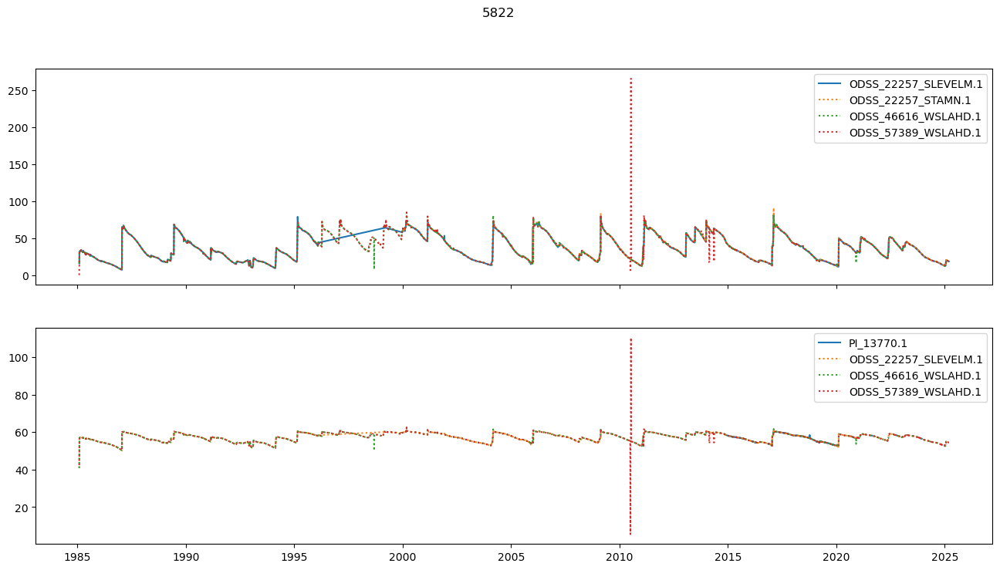

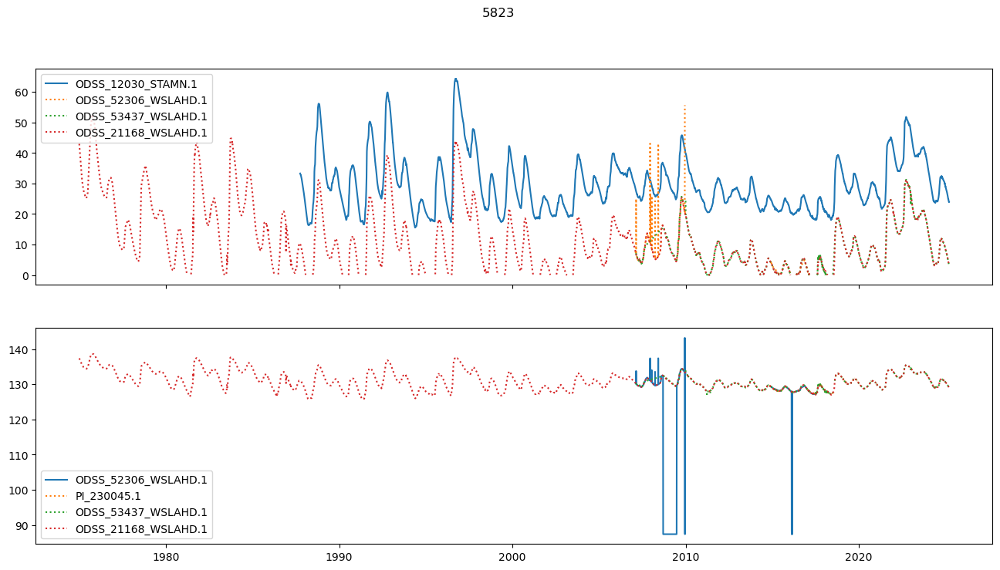

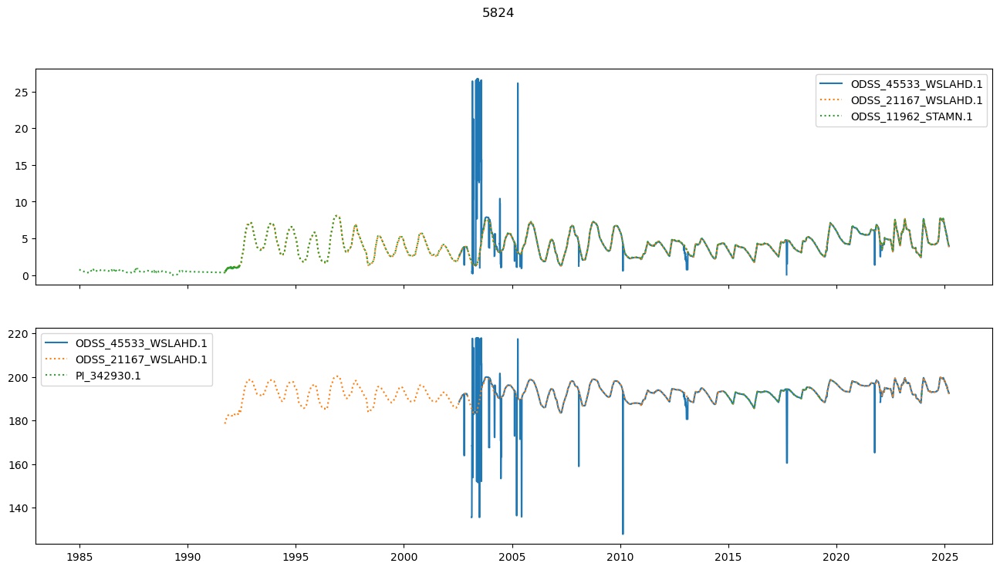

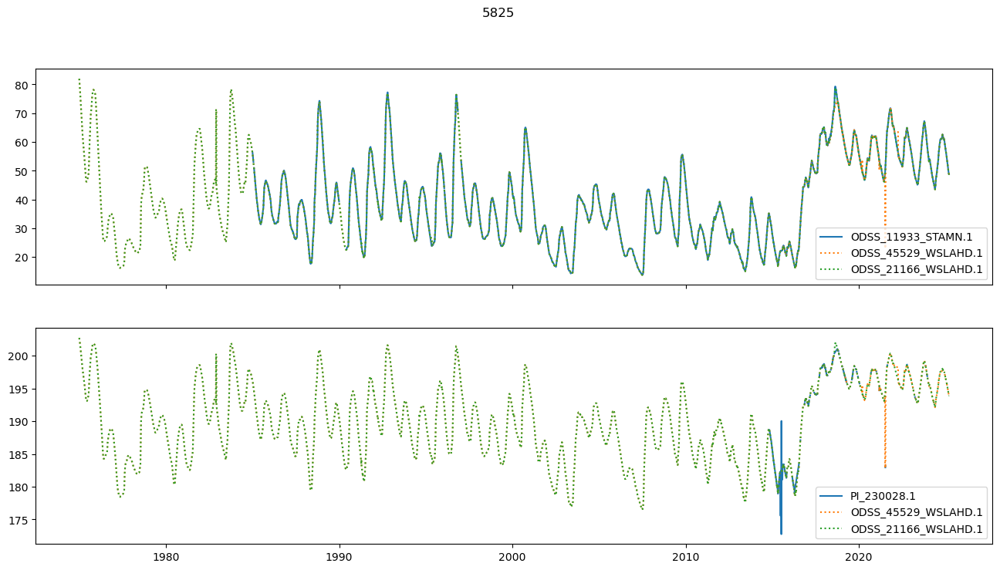

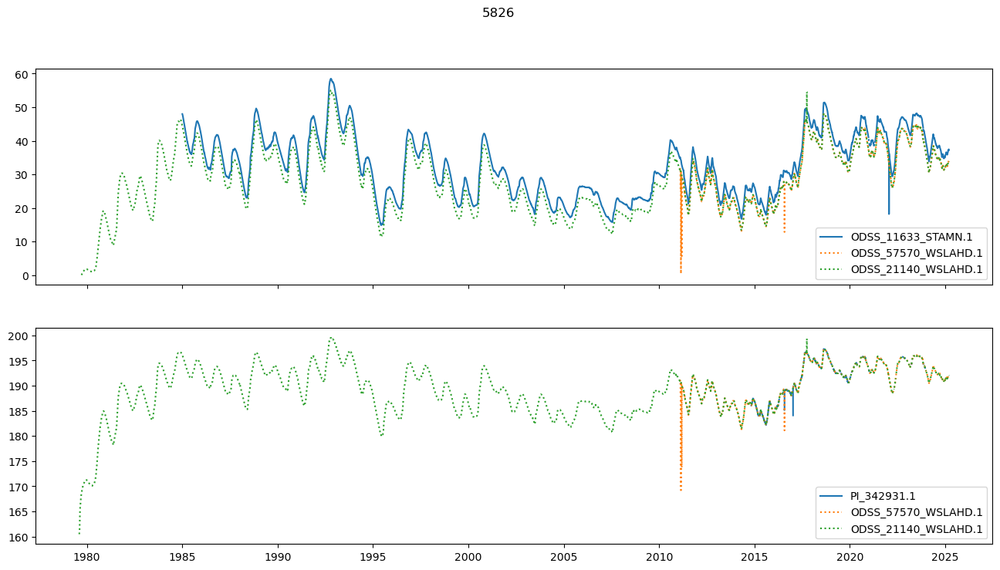

...

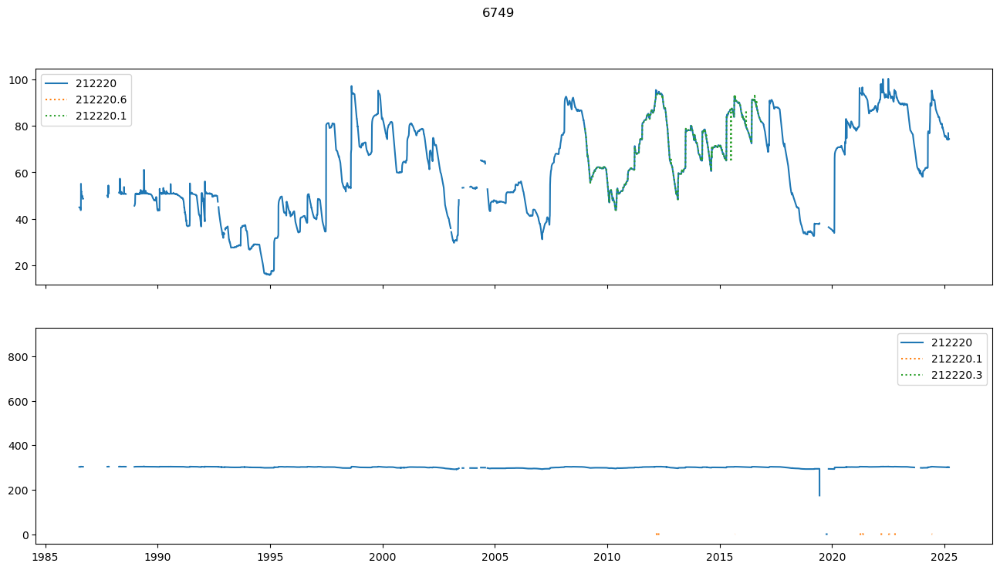

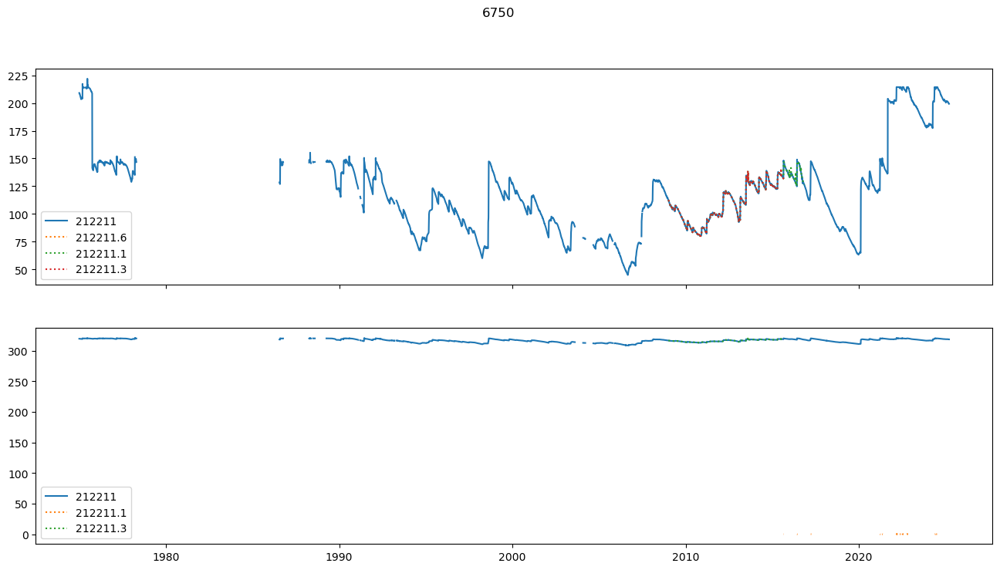

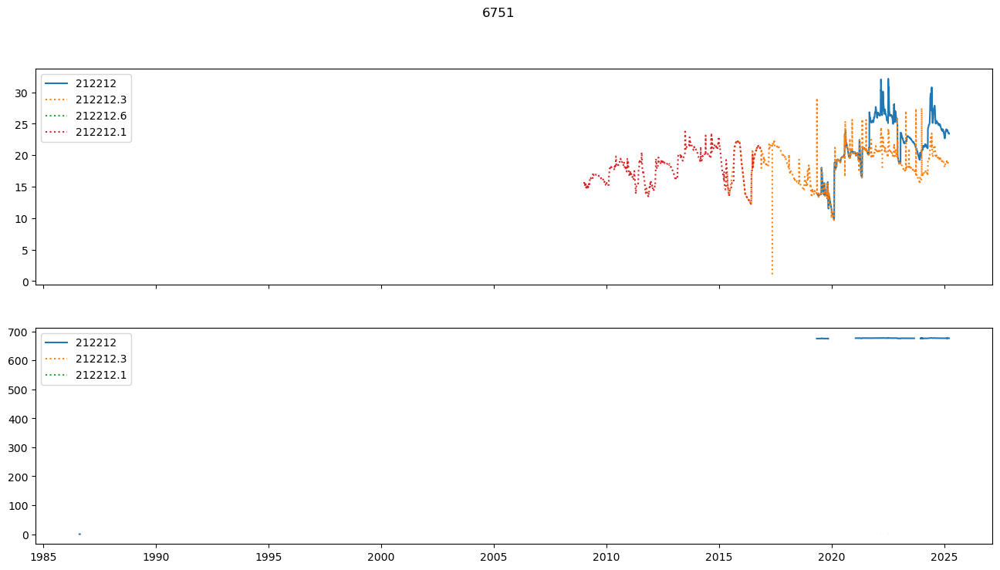

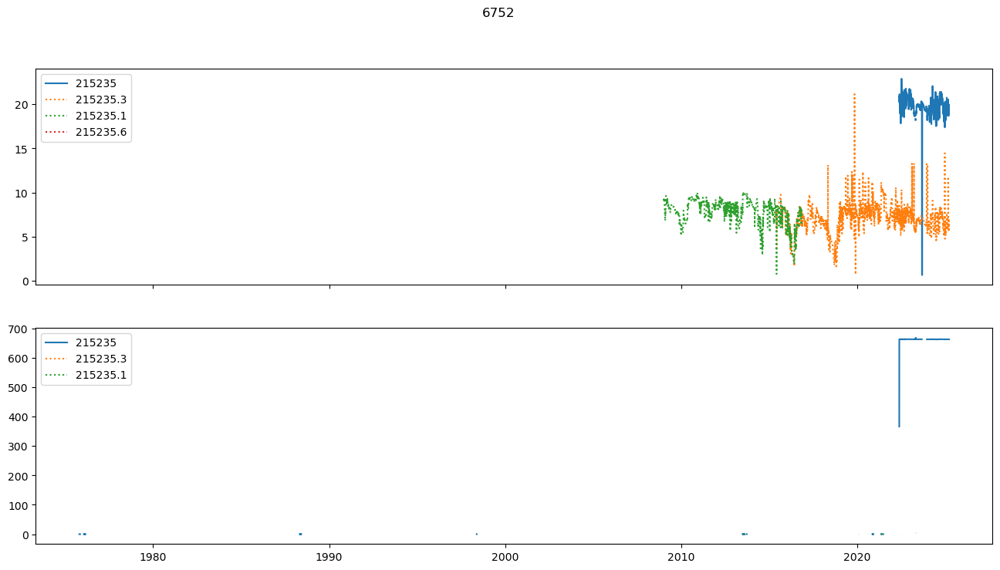

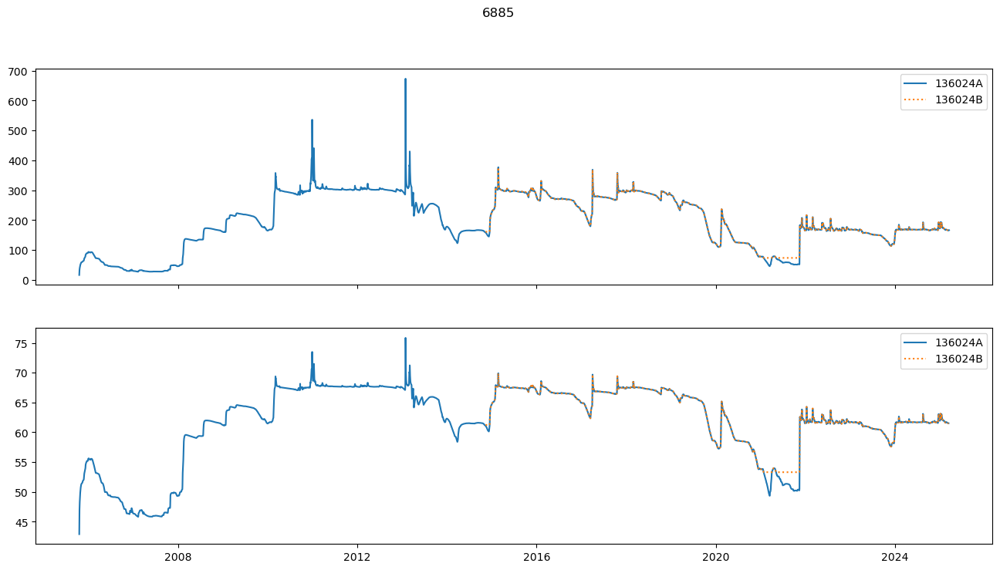

In [80]:
# load and plot time series
timeseries = {grand_id: {} for grand_id in duplicates}
for grand_id, dct in timeseries.items():#stations_sel.GRAND_ID.unique():
    
    subset = stations_sel[stations_sel.GRAND_ID == grand_id]

    for no in subset.index:
        ts = []    
        for var in ['volume', 'level']:
            file = cfg.PATH_OBS_TS / f'{no}_{var}.csv'
            if file.is_file():
                try:
                    ts_var = pd.read_csv(file, usecols=['Timestamp', 'Value'], index_col='Timestamp').squeeze()
                    ts_var.name = var
                    ts_var.index = pd.to_datetime(ts_var.index)
                    start, end = ts_var.first_valid_index(), ts_var.last_valid_index()
                    ts_var = ts_var[start:end]
                    ts_var[ts_var < 0] = np.nan
                    if var == 'volume':
                        ts_var /= 1000 # convert Ml to hm3
                        cap_mcm = grand.loc[grand_id, 'CAP_MCM'] # storage capacity in GRanD
                        ts_var[ts_var > 5 * cap_mcm] = np.nan
                    if var == 'level':
                        ts_var[ts_var > 2228] = np.nan # maximum altitude in Australia  
                        elev_masl = grand.loc[grand_id, 'ELEV_MASL'] # elevation in GRanD
                        ts_var[ts_var > 3 * elev_masl] = np.nan
                    ts.append(ts_var)
                except:
                    continue

        if len(ts) > 0:
            dct[no] = pd.concat(ts, axis=1)

    fig, axes = plt.subplots(nrows=2, figsize=(16, 8), sharex=True)
    for ax, var in zip(axes, ['volume', 'level']):
        i = 0
        for no, ts in dct.items():
            if var in ts.columns:
                ls = '-' if i == 0 else ':'
                ax.plot(ts[var], c=f'C{i}', ls=ls, label=no)
                i +=1
        ax.legend()
    fig.suptitle(grand_id)
    
    plt.savefig(cfg.PATH_OBS_TS / 'plots' / 'multiple_signals' / f'{grand_id}.jpg', dpi=300, bbox_inches='tight')

**Load timeseries**

In [83]:
select_timeseries = pd.read_csv('select_timeseries.csv', index_col='GRAND_ID')

C:\Users\casadje\AppData\Local\Temp\ipykernel_8920\1958577162.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrows=2, figsize=(16, 8), sharex=True)


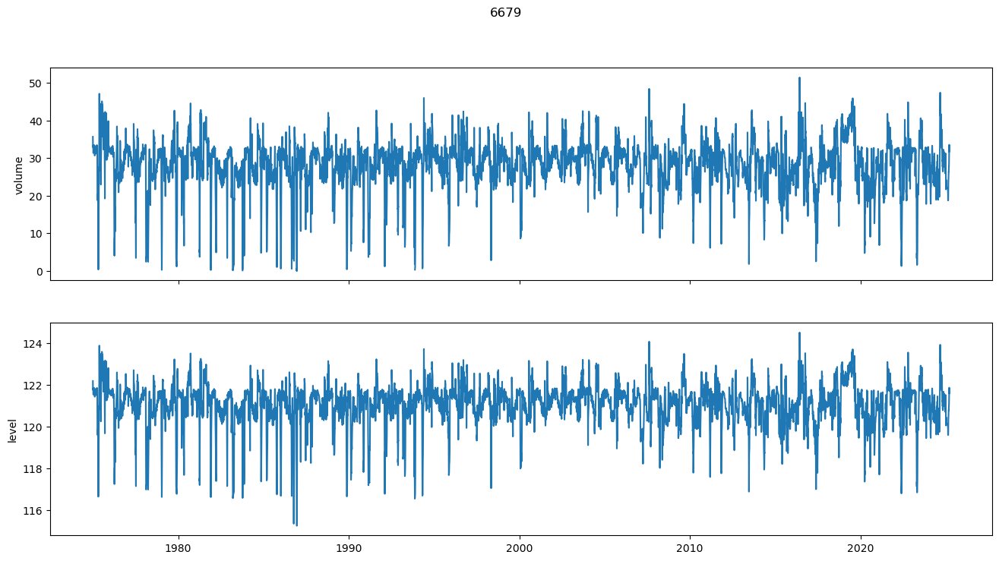

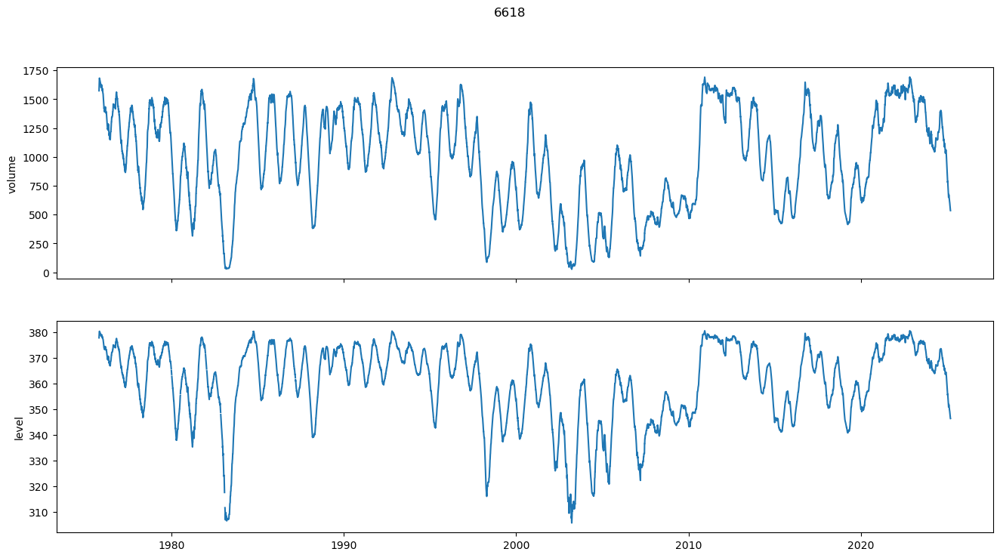

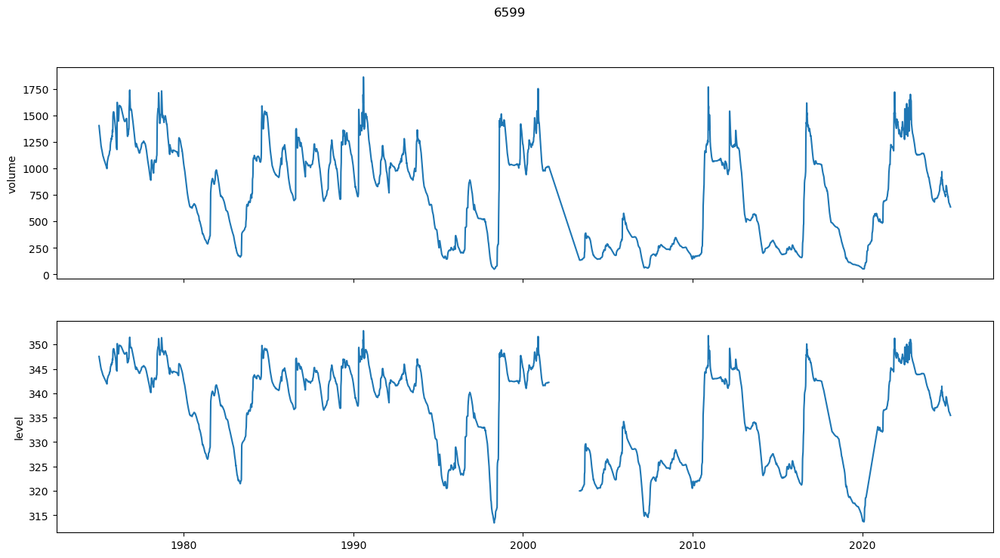

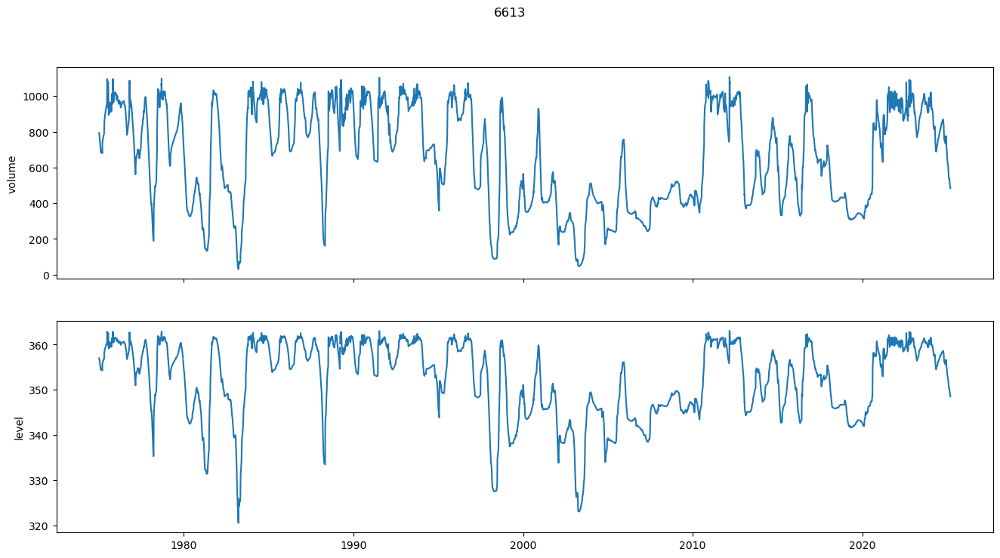

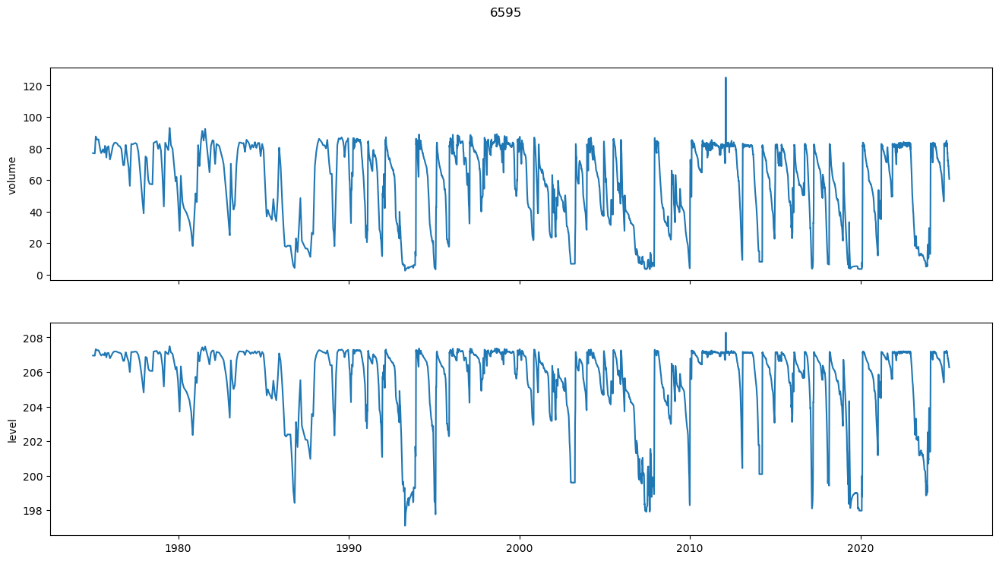

...

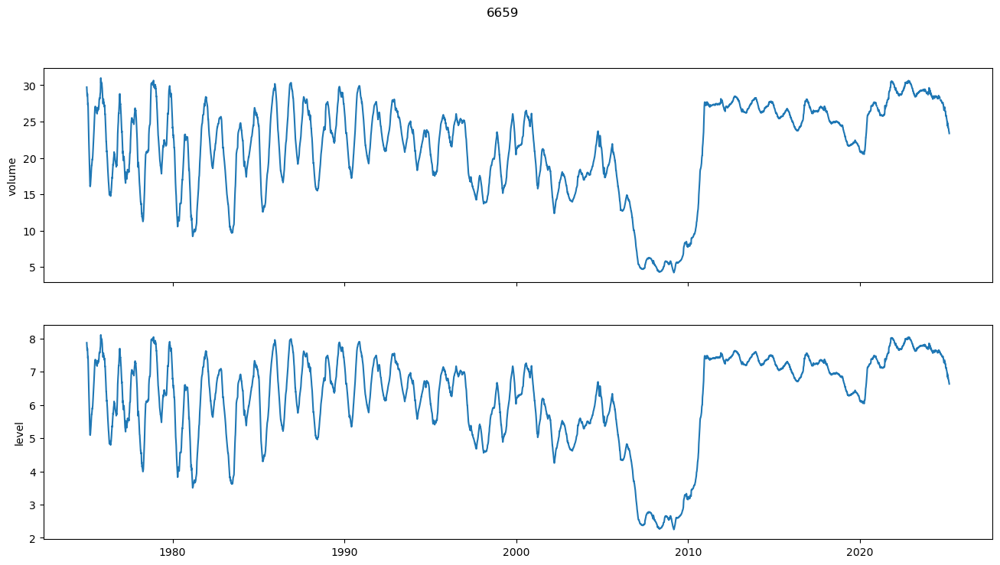

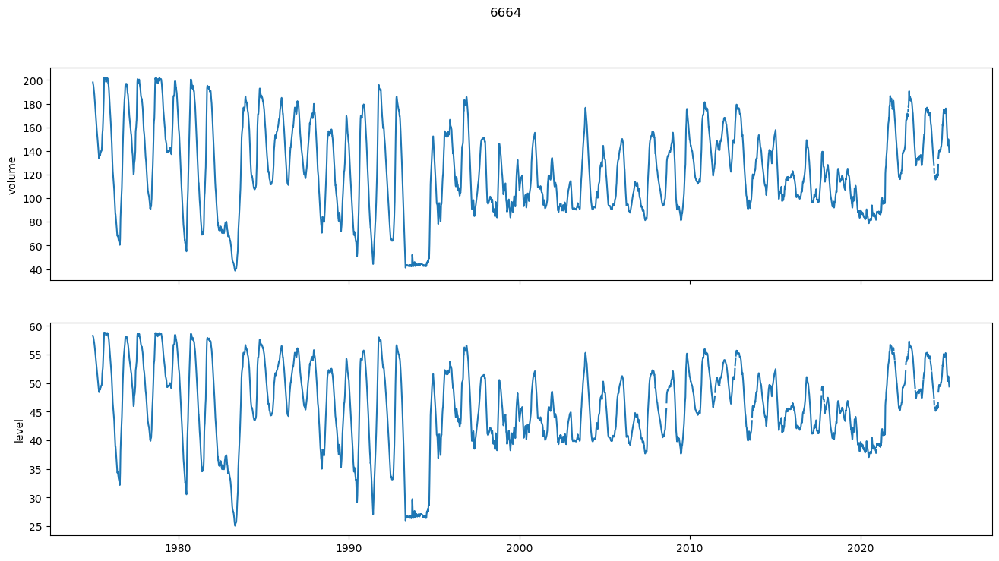

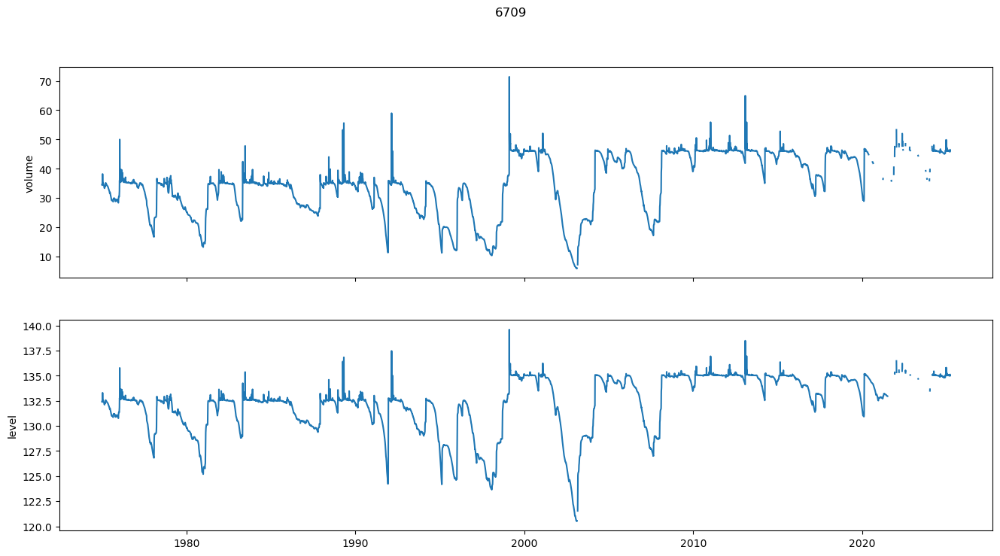

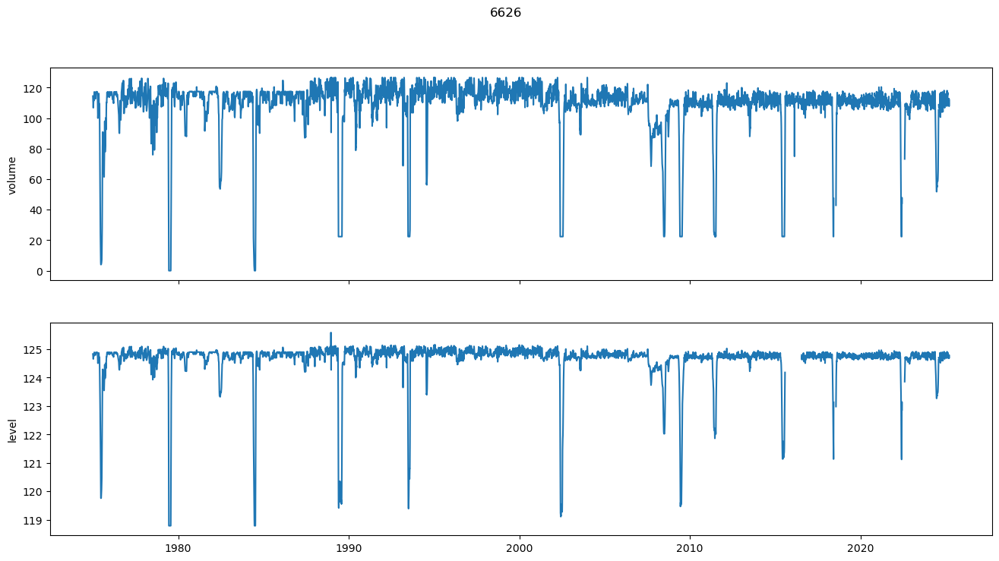

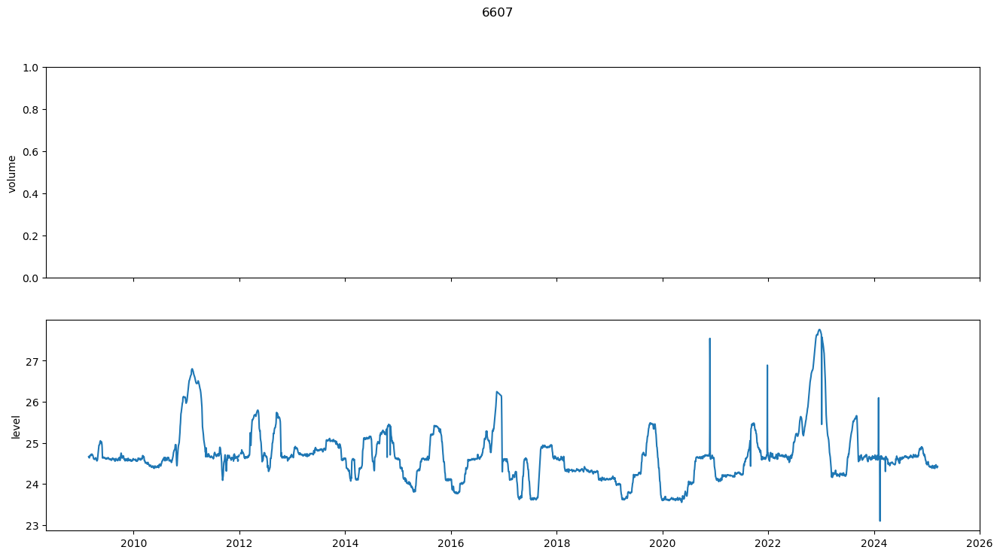

In [110]:
timeseries = {}
for grand_id in stations_sel.GRAND_ID.unique():

    if grand_id not in select_timeseries.index:

        no = stations_sel.loc[stations_sel.GRAND_ID == grand_id].index.item()
    
        ts = []    
        for var in ['volume', 'level']:
            file = cfg.PATH_OBS_TS / f'{no}_{var}.csv'
            if file.is_file():
                try:
                    ts_var = pd.read_csv(file, usecols=['Timestamp', 'Value'], index_col='Timestamp').squeeze()
                    ts_var.name = var
                    ts_var.index = pd.to_datetime(ts_var.index)
                    start, end = ts_var.first_valid_index(), ts_var.last_valid_index()
                    ts_var = ts_var[start:end]
                    ts_var[ts_var < 0] = np.nan
                    if var == 'volume':
                        ts_var /= 1000 # convert Ml to hm3
                        cap_mcm = grand.loc[grand_id, 'CAP_MCM'] # storage capacity in GRanD
                        ts_var[ts_var > 5 * cap_mcm] = np.nan
                    if var == 'level':
                        ts_var[ts_var > 2228] = np.nan # maximum altitude in Australia  
                        elev_masl = grand.loc[grand_id, 'ELEV_MASL'] # elevation in GRanD
                        ts_var[ts_var > 3 * elev_masl] = np.nan
                    ts.append(ts_var)
                except:
                    continue

        if len(ts) > 0:
            ts = pd.concat(ts, axis=1)
            timeseries[grand_id] = ts
            
        fig, axes = plt.subplots(nrows=2, figsize=(16, 8), sharex=True)
        for ax, var in zip(axes, ['volume', 'level']):
            if var in ts.columns:
                ax.plot(ts[var])
            ax.set_ylabel(var)    
            # ax.legend()
        fig.suptitle(grand_id);

        plt.savefig(cfg.PATH_OBS_TS / 'plots' / 'single_signal' / f'{grand_id}.jpg', dpi=300, bbox_inches='tight')

In [127]:
grand_ids = stations_sel.GRAND_ID.unique()
remove_grand_ids = pd.read_csv('remove_timeseries.csv').squeeze().tolist()
grand_ids = list(set(grand_ids).difference(remove_grand_ids))

In [128]:
len(grand_ids)

150

In [129]:
grand.columns

Index(['GRAND_ID', 'RES_NAME', 'DAM_NAME', 'ALT_NAME', 'RIVER', 'ALT_RIVER',
       'MAIN_BASIN', 'SUB_BASIN', 'NEAR_CITY', 'ALT_CITY', 'ADMIN_UNIT',
       'SEC_ADMIN', 'COUNTRY', 'SEC_CNTRY', 'YEAR', 'ALT_YEAR', 'REM_YEAR',
       'DAM_HGT_M', 'ALT_HGT_M', 'DAM_LEN_M', 'ALT_LEN_M', 'AREA_SKM',
       'AREA_POLY', 'AREA_REP', 'AREA_MAX', 'AREA_MIN', 'CAP_MCM', 'CAP_MAX',
       'CAP_REP', 'CAP_MIN', 'DEPTH_M', 'DIS_AVG_LS', 'DOR_PC', 'ELEV_MASL',
       'CATCH_SKM', 'CATCH_REP', 'DATA_INFO', 'USE_IRRI', 'USE_ELEC',
       'USE_SUPP', 'USE_FCON', 'USE_RECR', 'USE_NAVI', 'USE_FISH', 'USE_PCON',
       'USE_LIVE', 'USE_OTHR', 'MAIN_USE', 'LAKE_CTRL', 'MULTI_DAMS',
       'TIMELINE', 'COMMENTS', 'URL', 'QUALITY', 'EDITOR', 'LONG_DD', 'LAT_DD',
       'POLY_SRC', 'geometry', 'LON', 'LAT'],
      dtype='object')

In [134]:
lfcoords = grand.loc[grand_ids, ['LAT', 'LON', 'CATCH_SKM']]
lfcoords.index.name = 'ID'
lfcoords.rename(columns={'CATCH_SKM': 'area'}, inplace=True)
lfcoords.columns = lfcoords.columns.str.lower()
lfcoords.sort_index(inplace=True)

lfcoords.head()

,lat,lon,area
ID,,,
5822,-20.977411,117.107146,1082
5823,-31.957176,116.166155,1488
5824,-32.044234,116.068769,34
5825,-32.152641,116.128824,732
5826,-32.202662,116.065137,130


In [140]:
# export csv
lfcoords.to_csv(cfg.PATH_RESOPS / 'ancillary' / 'lfcoords' / 'grand.csv')

In [136]:
lfcoords.isnull().sum()

lat     0
lon     0
area    0
dtype: int64